**Advanced Lane Finding Project**

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.



### Compute the camera calibration matrix and distortion coefficients 

First let us compute the camera calibration matrix and distortion coefficients from set of images provided

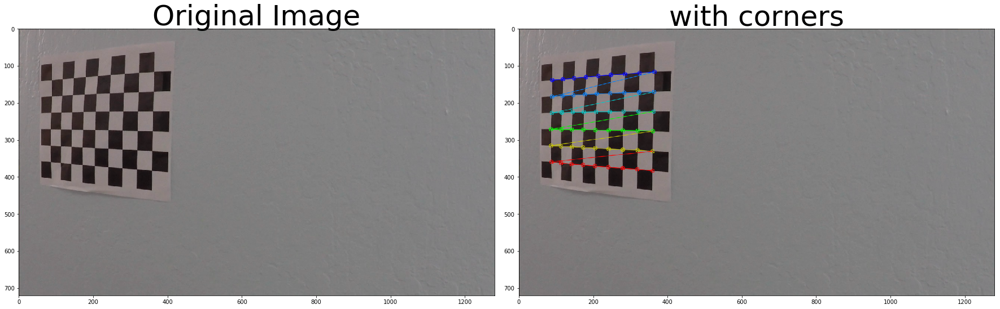

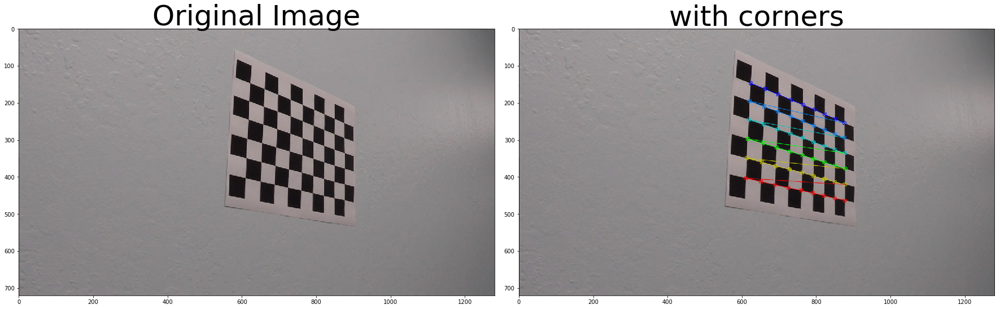

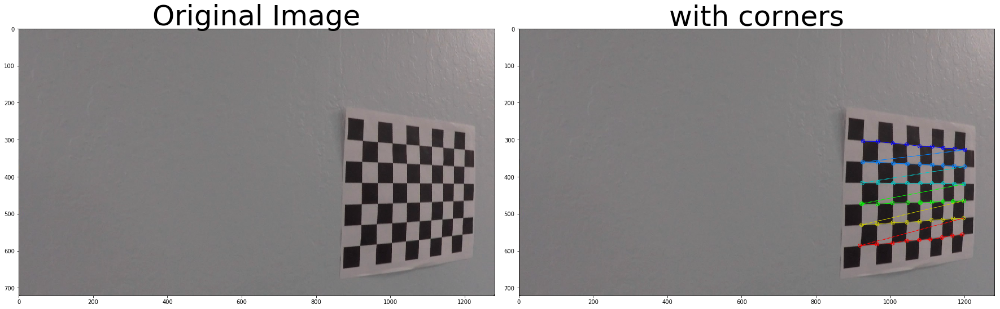

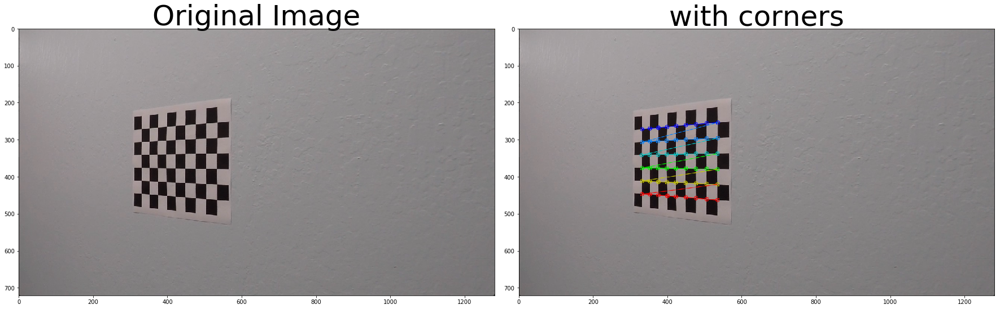

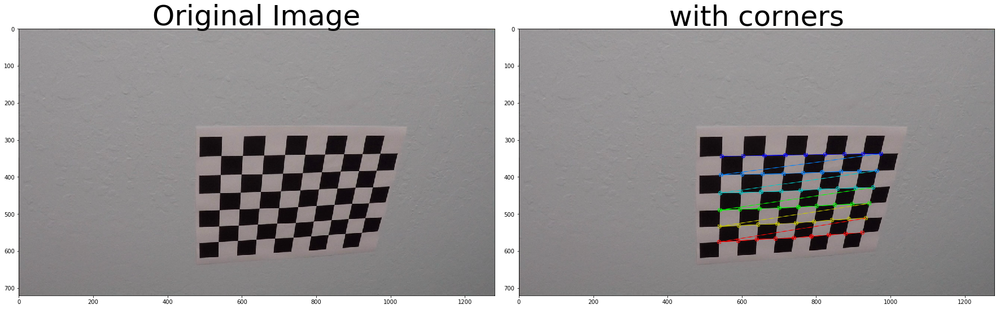

...

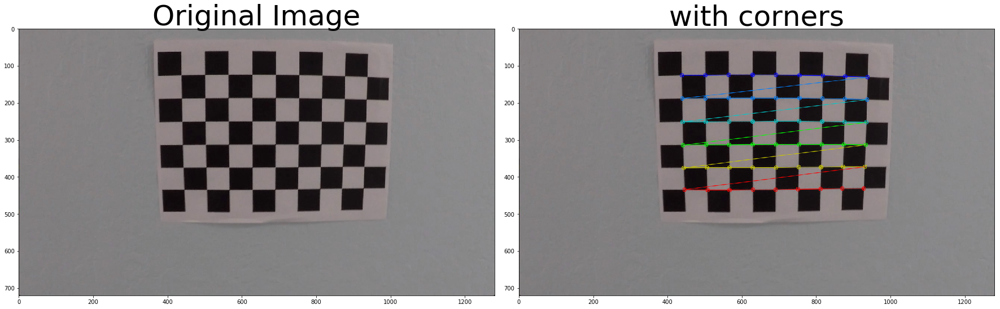

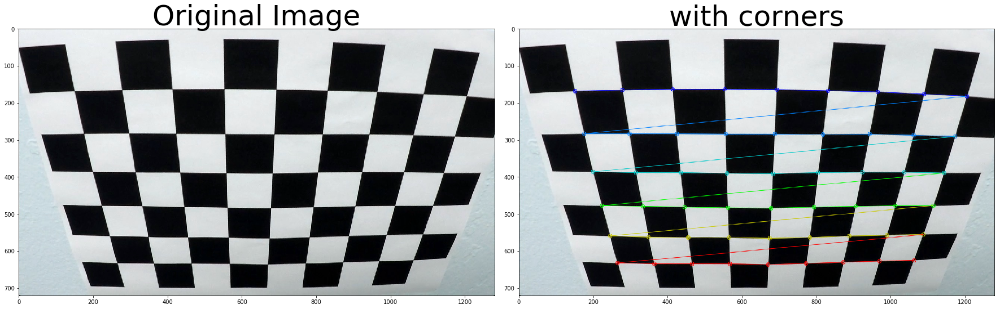

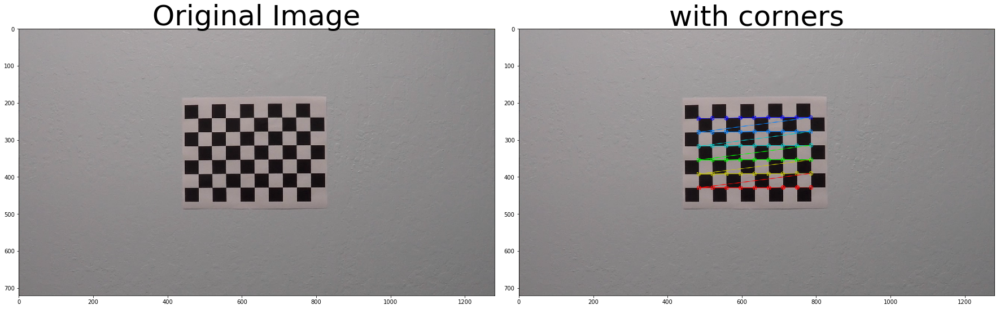

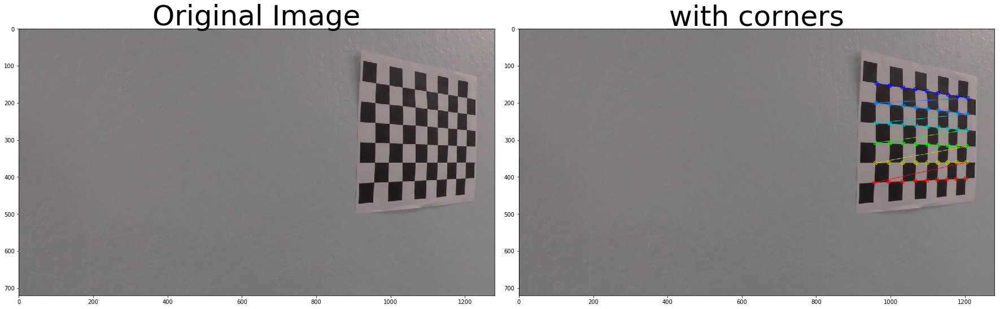

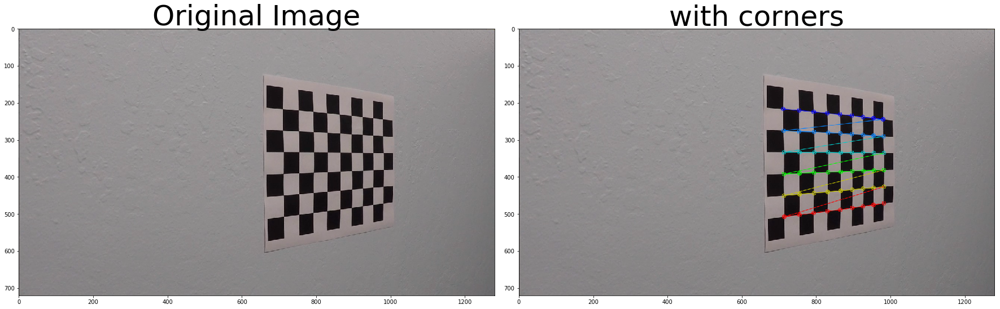

In [1]:
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib inline
nx = 9
ny = 6
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for i in images:
    img = cv2.imread(i)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        
        #write_name = 'corners_found'+str(idx)+'.jpg'
        #cv2.imwrite(write_name, img)
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=50)
        
        # Draw and display the corners
        cv2.drawChessboardCorners(img, (nx,ny), corners, ret)

        ax2.imshow(img)
        ax2.set_title('with corners', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        


Text(0.5,1,'Undistorted Image')

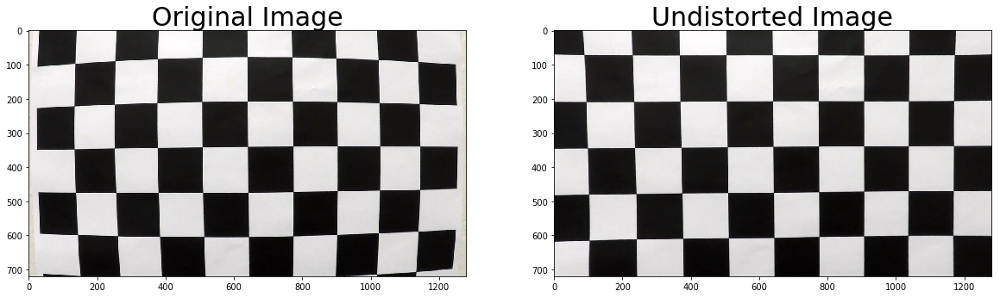

In [2]:

import pickle
%matplotlib inline
import matplotlib.image as mpimg
# Test undistortion on an image
img = mpimg.imread('camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)


undist1 = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite('camera_cal/calibration1_undist1.jpg',undist1)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "camera_cal/calibration1.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undist1)
ax2.set_title('Undistorted Image', fontsize=30)

Now since, image and object points required for image calibration are produced in the above step, lets us calibrate, calculate distortion coefficients, and undistortion  an image as follows and also save the calibration results for later use.  

#####  undistorting some test images

Text(0.5,1,'Undistorted Image')

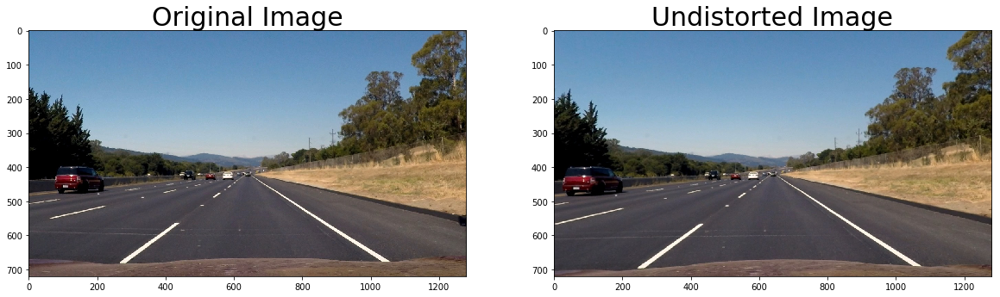

In [3]:

# define function to undistortion on an image
img11 = mpimg.imread('test_images/straight_lines2.jpg')
def undistort(image):
    img_size = (image.shape[1], image.shape[0])
    # Do camera calibration given object points and image points
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
    # use camera matrix to undistort the image
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    #cv2.imwrite('test_images/straight_lines2.jpg_undist.jpg',undist)
    
    return undist
undist = undistort(img11)
# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "test_images/straight_lines2_pickle.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img11)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=30)

Text(0.5,1,'Undistorted Image')

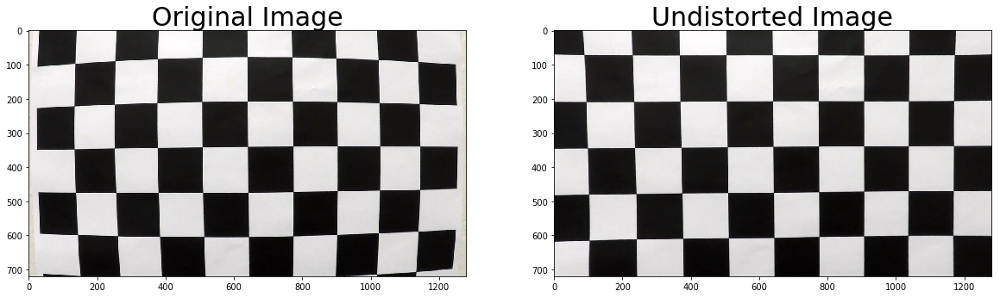

In [4]:
img1 = mpimg.imread('camera_cal/calibration1.jpg')
#img_size = (img.shape[1], img.shape[0])
undist1 = undistort(img1)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img1)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undist1)
ax2.set_title('Undistorted Image', fontsize=30)

### Perspective transform on an image

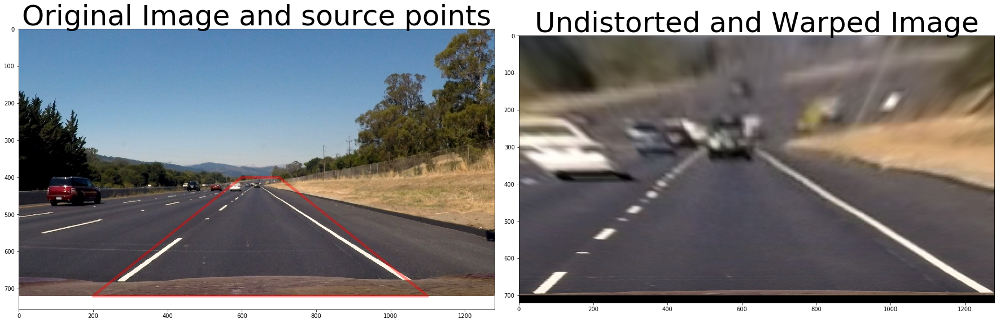

In [5]:
offset = 20 # offset for dst points
# Grab the image shape
#img_size = (gray.shape[1], gray.shape[0])
# let us define the source points manually

# For source points I'm grabbing the outer four detected corners
src = np.float32([(600,400),(700,400),(1100,720),(200,720)])


dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
# Given src and dst points, calculate the perspective transform matrix
M = cv2.getPerspectiveTransform(src, dst)
# Warp the image using OpenCV warpPerspective()
warped = cv2.warpPerspective(undist, M, img_size)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img11)
# Draw source points on to the original image
srcd = np.float32([(700,400),(600,400),(1100,720),(200,720)])
x = [srcd[0][0],srcd[2][0],srcd[3][0],srcd[1][0],srcd[0][0]]
y = [srcd[0][1],srcd[2][1],srcd[3][1],srcd[1][1],srcd[0][1]]
ax1.plot(x, y, color='r', alpha=0.4, linewidth=5, solid_capstyle='round', zorder=2)
ax1.set_title('Original Image and source points', fontsize=50)
ax2.imshow(warped)
ax2.set_title('Undistorted and Warped Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Use color transforms, gradients, etc., to create a thresholded binary image.

### Sobel transform

In [6]:


# Define a function that applies Sobel x or y, 
# then takes an absolute value and applies a threshold.
# Note: calling your function with orient='x', thresh_min=5, thresh_max=100
# should produce output like the example image shown above this quiz.
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output
# Run the function


### Sobel-x transform

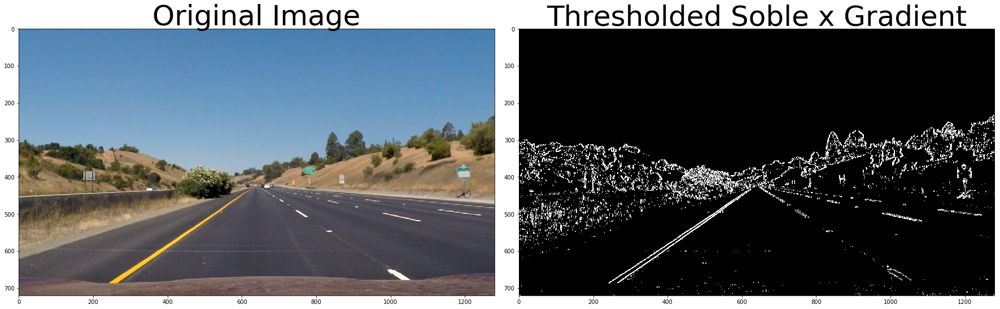

In [7]:
# Read in an image and grayscale it
img3 = mpimg.imread('test_images/straight_lines1.jpg')
grad_binary = abs_sobel_thresh(img3, orient='x', thresh_min=20, thresh_max=100)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img3)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(grad_binary, cmap='gray')
ax2.set_title('Thresholded Soble x Gradient', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Sobel-y transform

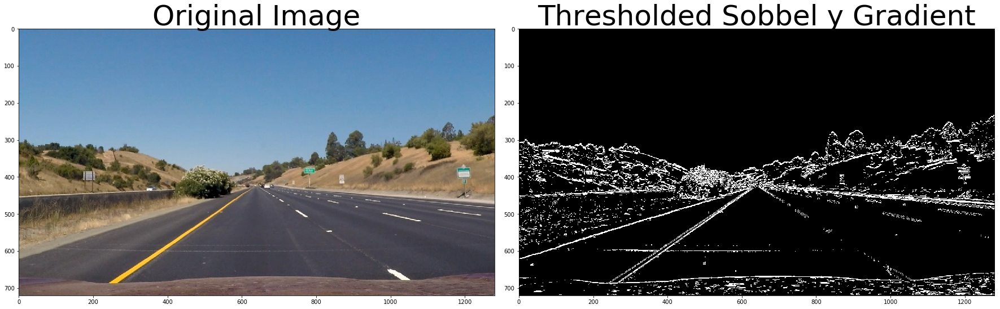

In [8]:
grad_binary = abs_sobel_thresh(img3, orient='y', thresh_min=20, thresh_max=100)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img3)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(grad_binary, cmap='gray')
ax2.set_title('Thresholded Sobbel y Gradient', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Magnitude thresholding

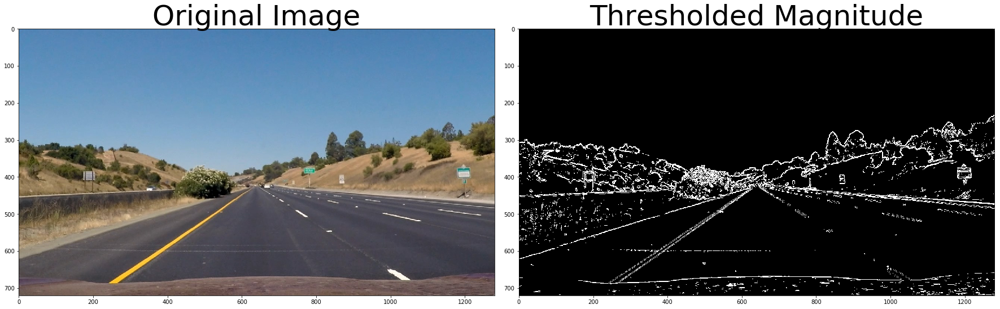

In [9]:
# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
# Define a function to return the magnitude of the gradient
# for a given sobel kernel size and threshold values
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    #scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

    
# Run the function
mag_binary = mag_thresh(img3, sobel_kernel=3, mag_thresh=(30, 100))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img3)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(mag_binary, cmap='gray')
ax2.set_title('Thresholded Magnitude', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Direction thresholding

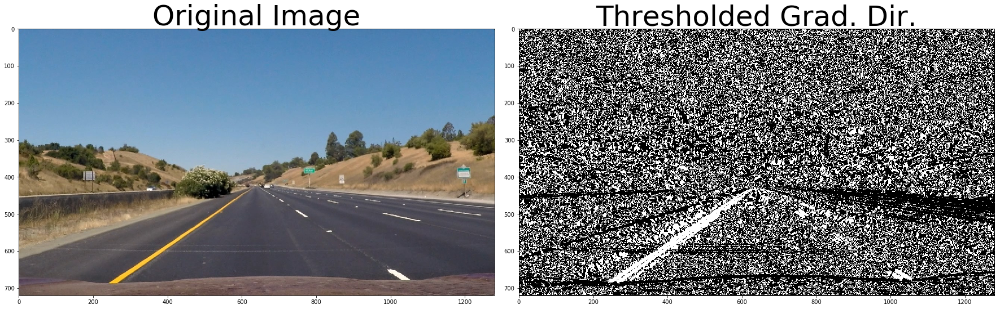

In [10]:

# Define a function that applies Sobel x and y, 
# then computes the direction of the gradient
# and applies a threshold.
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)    
    # 3) Take the absolute value of the x and y gradients
    abs_x = np.absolute(sobelx)
    abs_y = np.absolute(sobely)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient
    grad = np.arctan2(abs_y, abs_x)
    # 5) Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(grad)
       
    # 6) Return this mask as your binary_output image
    binary_output[(grad >= thresh[0]) & (grad <= thresh[1])] = 1 
    return binary_output
    
# Run the function
dir_binary = dir_threshold(img3, sobel_kernel=15, thresh=(0.6, 1.2))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img3)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Color and HLS thresholding 

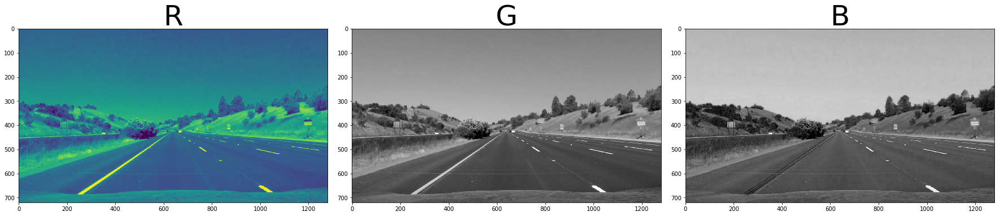

In [11]:
# let separate each color of the image as follows
R = img3[:,:,0]
G = img3[:,:,1]
B = img3[:,:,2]
f, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(R)
ax1.set_title('R', fontsize=50)
ax2.imshow(G, cmap='gray')
ax2.set_title('G', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
ax3.imshow(B, cmap='gray')
ax3.set_title('B', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

Since the outer lane color is yellow the R channel does a reasonable job of highlighting the lines, and we can apply a similar threshold to find lane-line pixels:

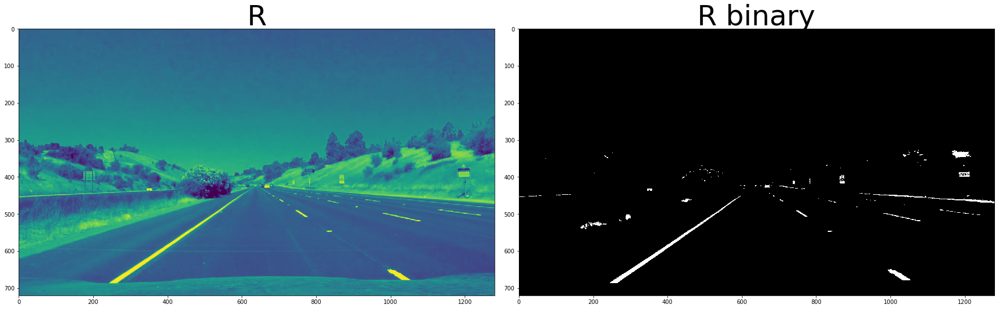

In [12]:
thresh = (200, 255)
binary = np.zeros_like(R)
binary[(R > thresh[0]) & (R <= thresh[1])] = 1
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(R)
ax1.set_title('R', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('R binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [13]:
# write a fucnction for color thresholding
def color_threshold(image,col,thresh = (200, 255)):
    # let separate each color of the image as follows
    R = image[:,:,0]
    G = image[:,:,1]
    B = image[:,:,2]
    binary = np.zeros_like(R)
    binary[(col > thresh[0]) & (col <= thresh[1])] = 1
    
    return binary,col


### Let us use the function above to color threshold and gradient 

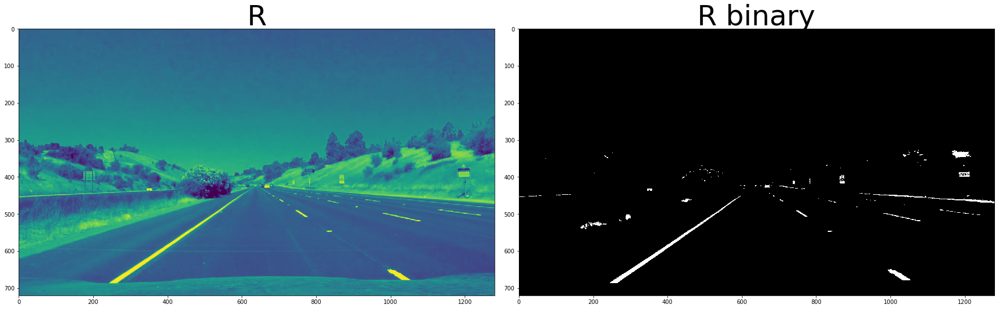

In [14]:
binary,R = color_threshold(img3,R,thresh = (200, 255))
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(R)
ax1.set_title('R', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('R binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)  

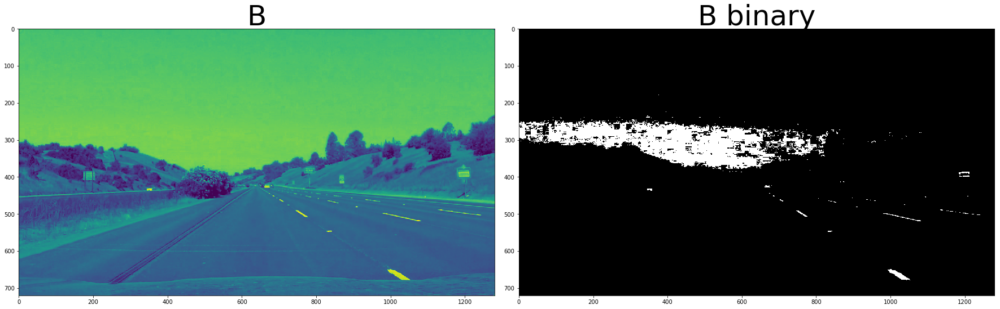

In [15]:
binary, B = color_threshold(img3,B,thresh = (200, 255))
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(B)
ax1.set_title('B', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('B binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)  

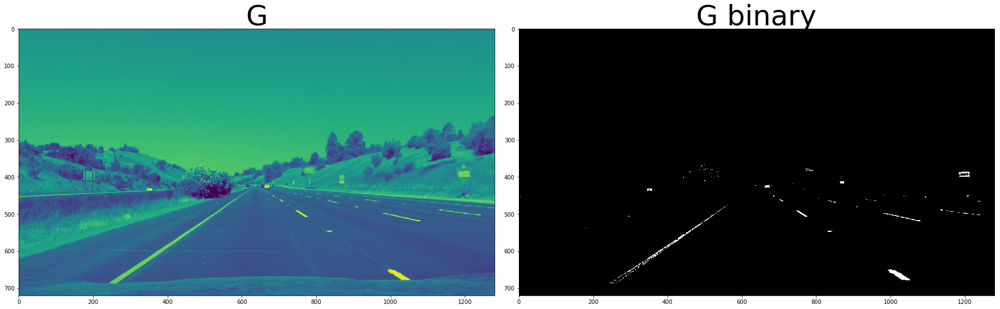

In [16]:
binary,G = color_threshold(img3,G,thresh = (200, 255))
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(G)
ax1.set_title('G', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('G binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)  

### HLS thresholding and gradient

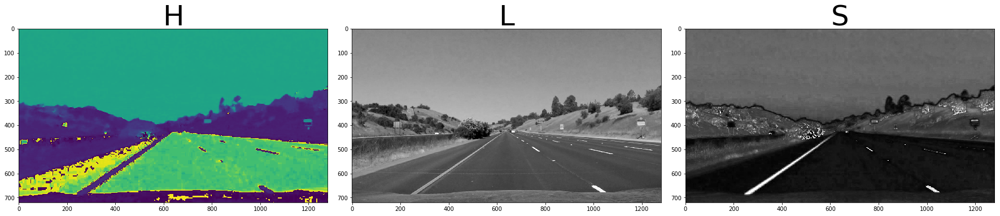

In [17]:
# convert an image to hls scale
hls = cv2.cvtColor(img3, cv2.COLOR_RGB2HLS)
H = hls[:,:,0]
L = hls[:,:,1]
S = hls[:,:,2]
f, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(H)
ax1.set_title('H', fontsize=50)
ax2.imshow(L, cmap='gray')
ax2.set_title('L', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
ax3.imshow(S, cmap='gray')
ax3.set_title('S', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

It looks like that the S channel has better detected the lane lines than the other two channels. lest us apply thresholding on the S-channel


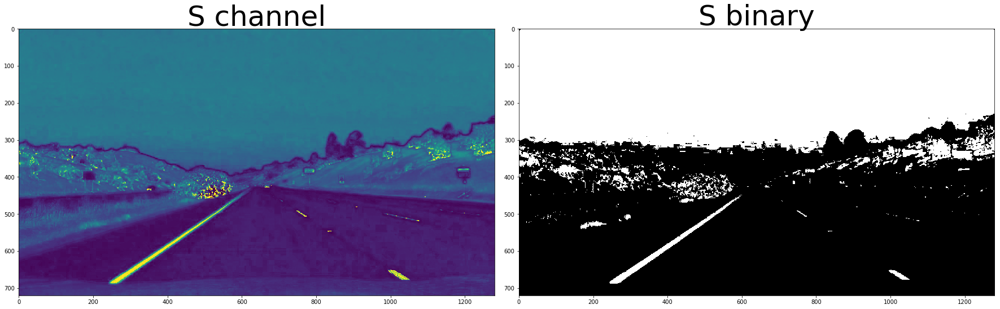

In [18]:
thresh = (90, 255)
binary = np.zeros_like(S)
binary[(S > thresh[0]) & (S <= thresh[1])] = 1
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(S)
ax1.set_title('S channel', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('S binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

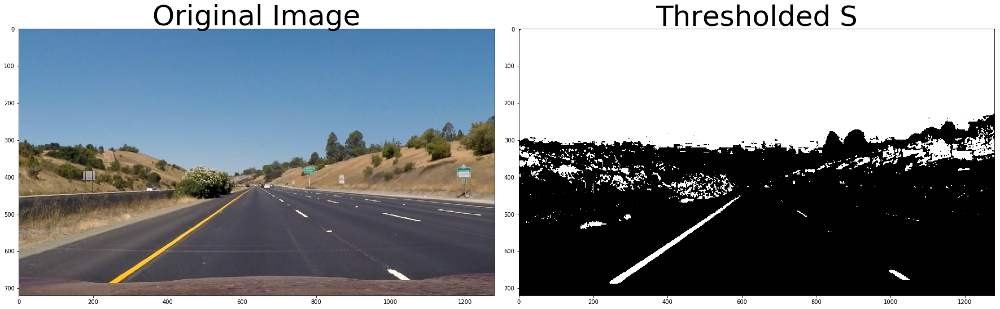

In [19]:
# Define a function that thresholds the S-channel of HLS
# Use exclusive lower bound (>) and inclusive upper (<=)
def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # 2) Apply a threshold to the S channel
    S = hls[:,:,2]
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    binary_output =  binary
    return binary_output
    
hls_binary = hls_select(img3, thresh=(90, 255))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img3)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hls_binary, cmap='gray')
ax2.set_title('Thresholded S', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#### Undistort the binary image

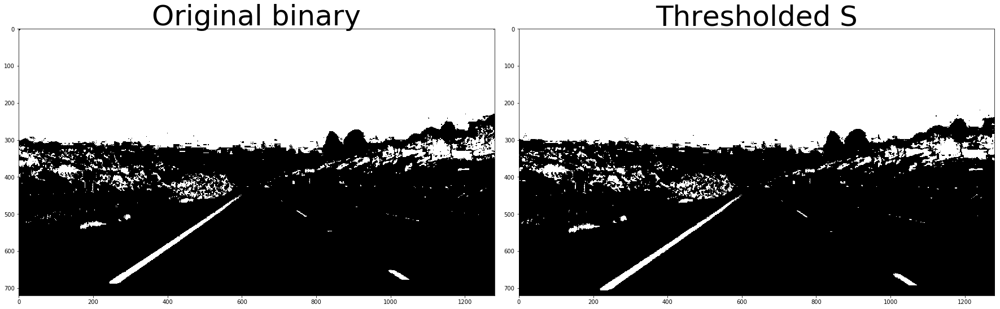

In [20]:
hls_binary_undis = undistort(hls_binary)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(hls_binary,cmap='gray')
ax1.set_title('Original binary', fontsize=50)
ax2.imshow(hls_binary_undis, cmap='gray')
ax2.set_title('Thresholded S', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Apply a perspective transform to rectify binary image ("birds-eye view")

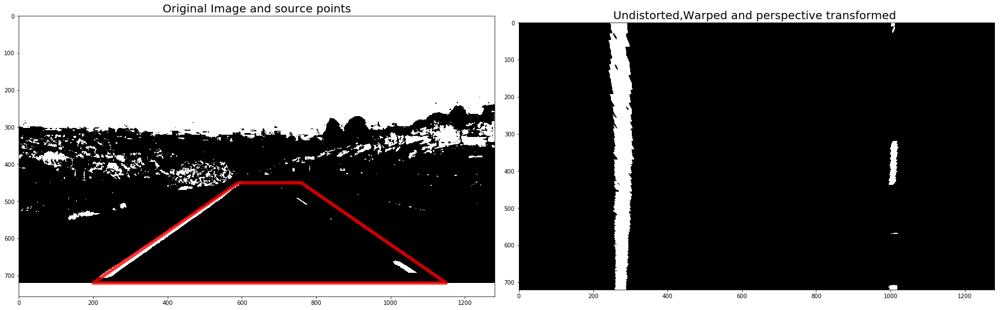

In [141]:
## Define a function to perform perspecive transform on undistoreted images
undist = undistort(hls_binary)
def perspectiv_trans(img):
    undist = undistort(img)
    img_size  = (img.shape[1], img.shape[0])
    w,h = (img.shape[1], img.shape[0])
    offset = 0 # offset for dst points
    # Grab the image shape
    #img_size = (gray.shape[1], gray.shape[0])
    # let us define the source points manually
    #src = np.array([(590,450),(760,450),(1150,720),(200,720)],np.float32)
    src = np.float32([(575,464),
                  (707,464), 
                  (258,682), 
                  (1049,682)])
    dst = np.float32([(270,0),
                  (w-270,0),
                  (270,h),
                  (w-270,h)])
    #dst = np.array([[offset, offset], [img_size[0]-offset, offset], 
    #                                [img_size[0]-offset, img_size[1]-offset], 
    #                              [offset, img_size[1]-offset]],np.float32)
    
    
    # Source and destination point

    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(undist, M, img_size)
    
    return warped,Minv

warped,Minv = perspectiv_trans(hls_binary)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(undist,cmap='gray')
# Draw source points on to the original image
srcd = np.float32([(760,450),(590,450),(1150,720),(200,720)])
x = [srcd[0][0],srcd[2][0],srcd[3][0],srcd[1][0],srcd[0][0]]
y = [srcd[0][1],srcd[2][1],srcd[3][1],srcd[1][1],srcd[0][1]]
ax1.plot(x, y, color='r', alpha=0.8, linewidth=6, solid_capstyle='round', zorder=2)
ax1.set_title('Original Image and source points', fontsize=20)
ax2.imshow(warped,cmap='gray')
ax2.set_title('Undistorted,Warped and perspective transformed ', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Comibining hls and gradient thresholding

The follwoing functiong will combine hls and gradient thresholding to produce binarry image

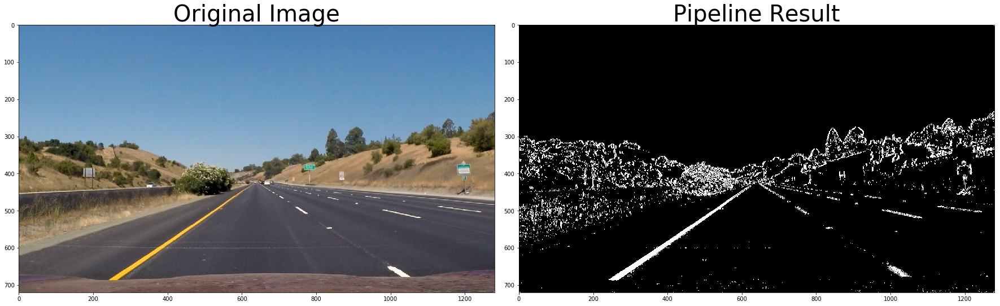

In [143]:
img6 =  mpimg.imread('test_images/straight_lines1.jpg')

# Edit this function to create your own pipeline.
def combined(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    undist = undistort(img)
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    
    return combined_binary,undist
    
combined_binary = combined(img6)[0]

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(img6)
ax1.set_title('Original Image', fontsize=40)

ax2.imshow(combined_binary,cmap ="gray")
ax2.set_title('Pipeline Result', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Undistort and  perspective transform on the combined image

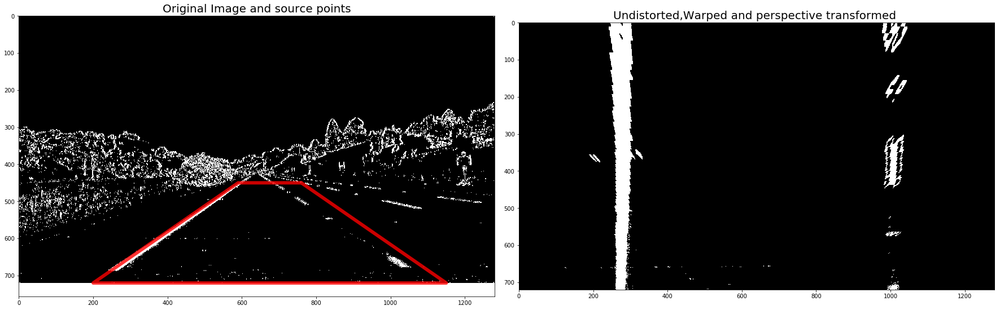

In [30]:
# call the function 'perspectiv_trans' that perform undistortion and 
# perspective transform on the combined image

comb_persp = perspectiv_trans(combined_binary)[0]

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow( combined_binary,cmap='gray')
# Draw source points on to the original image
srcd = np.float32([(760,450),(590,450),(1150,720),(200,720)])
x = [srcd[0][0],srcd[2][0],srcd[3][0],srcd[1][0],srcd[0][0]]
y = [srcd[0][1],srcd[2][1],srcd[3][1],srcd[1][1],srcd[0][1]]
ax1.plot(x, y, color='r', alpha=0.8, linewidth=6, solid_capstyle='round', zorder=2)
ax1.set_title('Original Image and source points', fontsize=20)
ax2.imshow(comb_persp,cmap='gray')
ax2.set_title('Undistorted,Warped and perspective transformed ', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### All images, undistort and perspective transform on the combined image

['test_images/test1.jpg', 'test_images/straight_lines2.jpg', 'test_images/test5.jpg', 'test_images/test4.jpg', 'test_images/test3.jpg', 'test_images/test2.jpg', 'test_images/test6.jpg', 'test_images/straight_lines1.jpg']


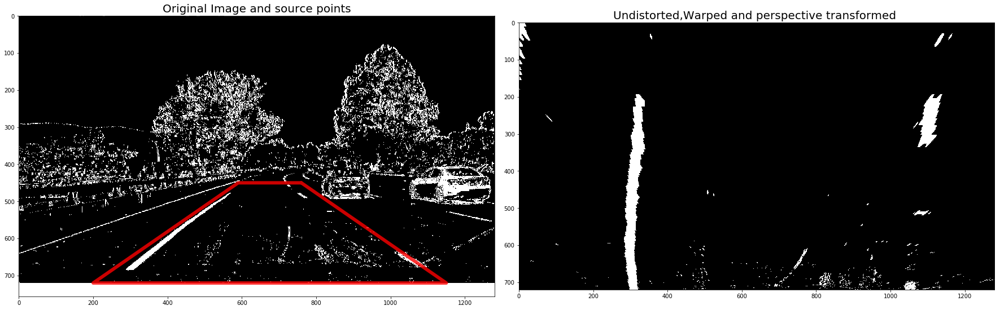

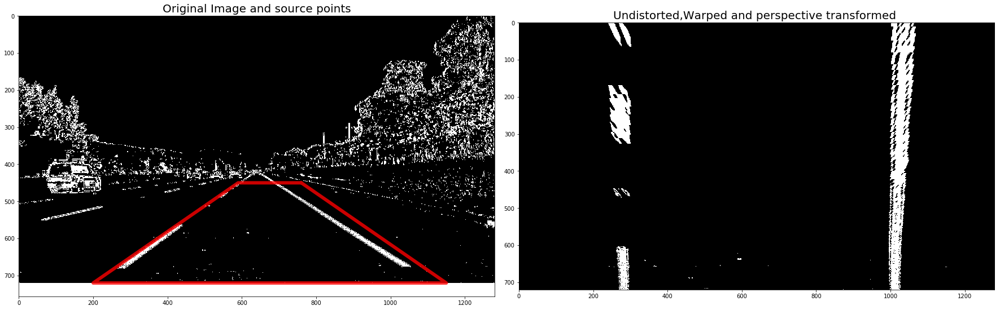

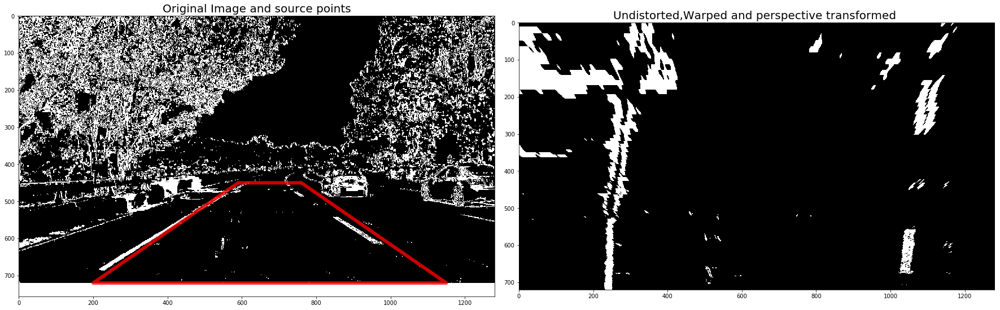

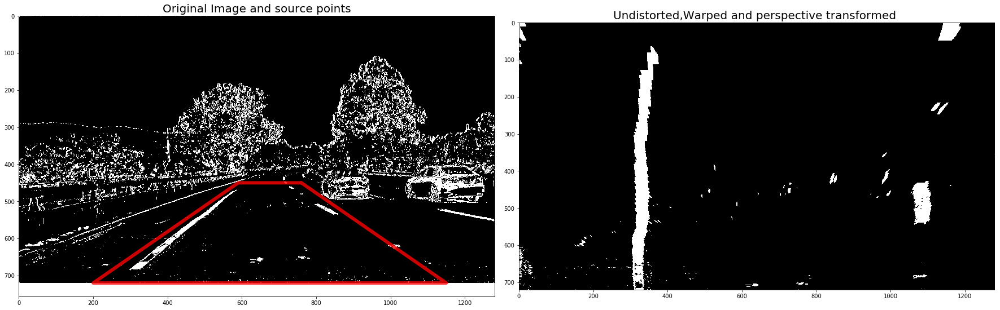

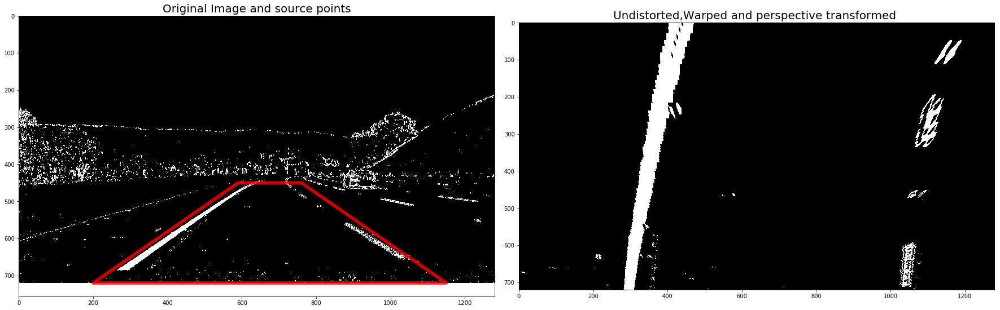

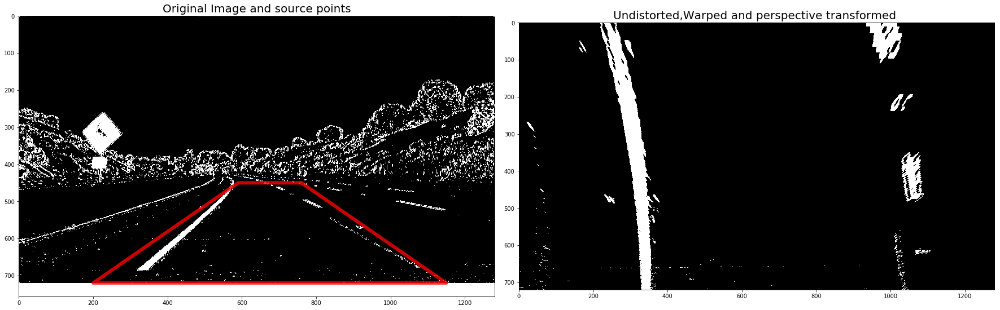

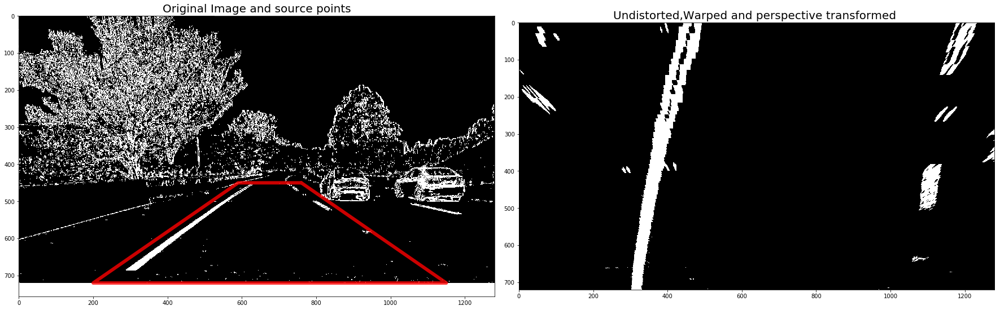

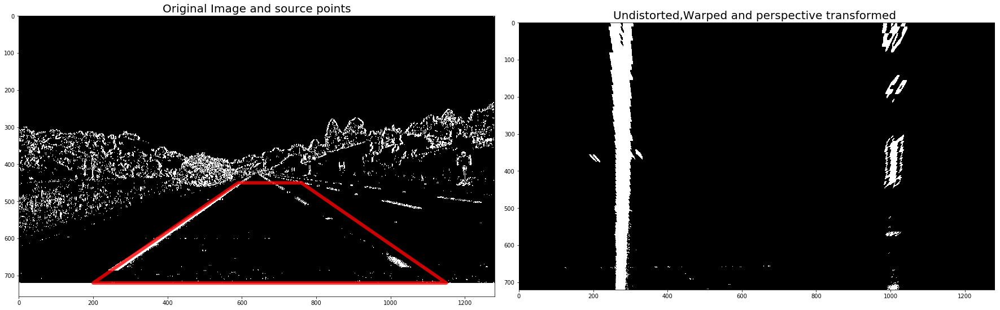

In [31]:
images_lst = glob.glob('test_images/*.jpg')
print(images_lst)
# Step through the list and search for chessboard corners
for i in images_lst:
    img = cv2.imread(i)
    #print(img)
    combined_binary = combined(img)[0]
    comb_persp = perspectiv_trans(combined_binary)[0]
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 12))
    f.tight_layout()
    ax1.imshow(combined_binary,cmap='gray')
    # Draw source points on to the original image
    srcd = np.float32([(760,450),(590,450),(1150,720),(200,720)])
    x = [srcd[0][0],srcd[2][0],srcd[3][0],srcd[1][0],srcd[0][0]]
    y = [srcd[0][1],srcd[2][1],srcd[3][1],srcd[1][1],srcd[0][1]]
    ax1.plot(x, y, color='r', alpha=0.8, linewidth=6, solid_capstyle='round', zorder=2)
    ax1.set_title('Original Image and source points', fontsize=20)
    ax2.imshow(comb_persp,cmap='gray')
    ax2.set_title('Undistorted,Warped and perspective transformed ', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Detect lane pixels and fit to find the lane boundary.

After we have a transformed binary image with clear lanes detected, we can now plot the histogram plot a histogram to identify which pixels are part of the lines and which belong to the left line and which belong to the right line. 

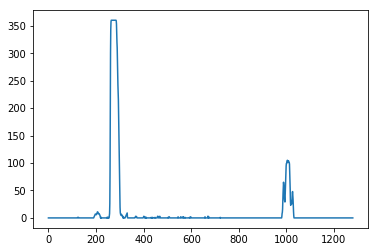

In [32]:
img6 =  mpimg.imread('test_images/straight_lines1.jpg')
combined_b = combined(img6)[0]
comb_prp = perspectiv_trans(combined_b)[0]

def hist(img):
    # TO-DO: Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[img.shape[0]//2:,:]

    # TO-DO: Sum across image pixels vertically - make sure to set `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram =np.sum(bottom_half, axis=0)
    
    return histogram

# Create histogram of image binary activations
histogram = hist(comb_prp )

# Visualize the resulting histogram
plt.plot(histogram)

### Sliding Window
The above histogram plot detected two peaks which can be used as a basis x-position to identify the left and right lanes. And from that we can use  a sliding window, placed around the line centers, to find and follow the lines up to the top of the frame

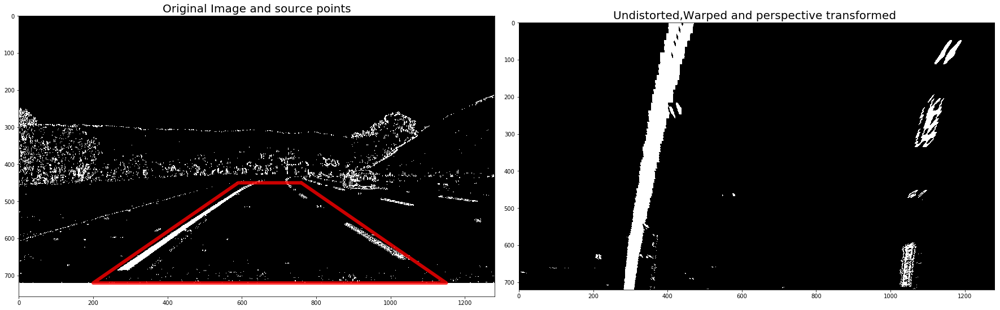

In [234]:
img_new1 =  mpimg.imread('test_images/test3.jpg')
combined_new1 = combined(img_new1)[0]
undist = combined(img_new1)[1]
comb_prp_new1 = perspectiv_trans(combined_new1)[0]
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(combined_new1,cmap='gray')
# Draw source points on to the original image
srcd = np.float32([(760,450),(590,450),(1150,720),(200,720)])
x = [srcd[0][0],srcd[2][0],srcd[3][0],srcd[1][0],srcd[0][0]]
y = [srcd[0][1],srcd[2][1],srcd[3][1],srcd[1][1],srcd[0][1]]
ax1.plot(x, y, color='r', alpha=0.8, linewidth=6, solid_capstyle='round', zorder=2)
ax1.set_title('Original Image and source points', fontsize=20)
ax2.imshow(comb_prp_new1,cmap='gray')
ax2.set_title('Undistorted,Warped and perspective transformed ', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [166]:
class Line():
    
    def __init__(self):
        
        self.detected = False
        
        self.recent_xfits = []
        self.best_xfit = None
        
        self.current_fit_coeffs = [np.array([False])]
        self.best_fit_coeffs = None
                
        self.radius_of_curvature = None
        self.line_base_position = None
        
        self.allx = None
        self.ally = None

In [57]:

def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 150
    # Set minimum number of pixels found to recenter window
    minpix = 60

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]


    return leftx, lefty, rightx, righty




### Fit polynomial
After finding all pixels belonging to each line through the sliding window method, we can fit a polynomial to the line

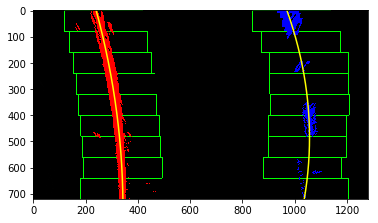

In [172]:

def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img,left_fit,right_fit,ploty


out_img = fit_polynomial(comb_prp_new1)[0]

plt.imshow(out_img)


### Fucntion to identify lane line and perform polynomial fit

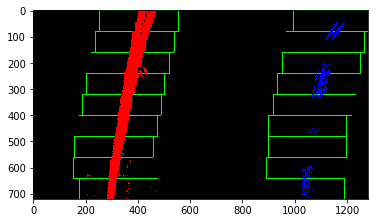

In [257]:
leftl = Line()
rightl = Line()
def find_lane_pixels_and_ployfit(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 150
    # Set minimum number of pixels found to recenter window
    minpix = 60

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
        # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
   # plt.plot(left_fitx, ploty, color='yellow')
   # plt.plot(right_fitx, ploty, color='yellow')
    
            
    leftl.recent_xfits = [(left_fitx)]
    leftl.best_xfit = np.mean(leftl.recent_xfits)
    rightl.recent_xfits = [(right_fitx)]
    rightl.best_xfit = np.mean(rightl.recent_xfits)
        
    leftl.current_fit_coeffs = [(left_fit)]
    leftl.best_fit_coeffs = np.mean(leftl.current_fit_coeffs)
    rightl.current_fit_coeffs = [(right_fit)]
    rightl.best_fit_coeffs = np.mean(rightl.current_fit_coeffs)
    
    leftl.line_base_position = leftx_current
    rightl.line_base_position = rightx_current
    
    leftl.allx = leftx
    leftl.ally = lefty
    rightl.allx = rightx
    rightl.ally = righty

    return out_img,left_fit,right_fit,ploty,left_fitx, right_fitx,leftx,lefty, rightx,righty, leftx_base, rightx_base
   
out_img11,left_fit,right_fit,ploty,left_fitx, right_fitx,leftx,lefty, rightx,righty, leftx_base, rightx_base = find_lane_pixels_and_ployfit(comb_prp_new1)
plt.imshow(out_img11)

### Search lane pixel around prevously fitted polynomial

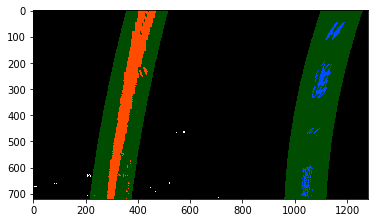

In [283]:
def findpixel_around_poly(binary_warped,left_fit,right_fit):
    #left_fit = find_lane_pixels_and_ployfit(binary_warped)[1]
    #right_fit = find_lane_pixels_and_ployfit(binary_warped)[2]
    out_img,left_fit,right_fit,ploty,left_fitx, right_fitx,leftx,lefty, rightx,righty,leftx_base, rightx_base = find_lane_pixels_and_ployfit(comb_prp_new1)
    img_shape = binary_warped.shape
    
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 80

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    if left_fitx.all() != 0:
        leftl.detected == True
    else:
        left.detected == False
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    if right_fitx.all() != 0:
        rightl.detected == True
    else:
        rightl.detected == False
   # left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result,left_fitx, right_fitx, ploty,left_fitx, right_fitx,leftx,lefty, rightx,righty, leftx_base, rightx_base

plt.imshow(findpixel_around_poly(comb_prp_new1,left_fit,right_fit)[0])

### Without sliding windows



In [71]:
def fit_poly(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img,left_lane_inds,good_left_inds = find_lane_pixels(comb_prp_new1)
    #leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
    #rightx = rightx[::-1]  # Reverse to match top-to-bottom in y
    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img,left_fit,right_fit,ploty



TypeError: fit_poly() takes 1 positional argument but 5 were given

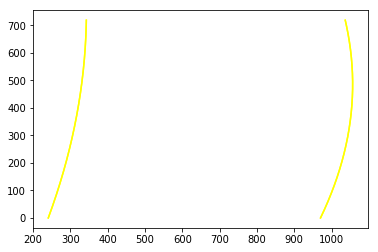

In [74]:
def search_around_poly(binary_warped):
    left_fit = fit_polynomial(binary_warped)[1]
    right_fit = fit_polynomial(binary_warped)[2]
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result,left_fitx, right_fitx, ploty

# Run image through the pipeline
# Note that in your project, you'll also want to feed in the previous fits
result,left_fitx, right_fitx, ploty = search_around_poly(comb_prp_new1) #,fit_polynomial(comb_prp_new1)[1],fit_polynomial(comb_prp_new1)[2])

# View your output
plt.imshow(result)

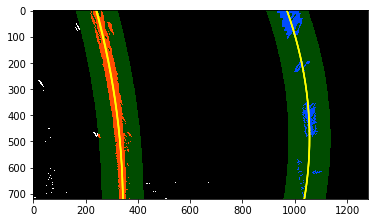

In [145]:


def search_around_poly2(binary_warped):
    left_fit = fit_polynomial(binary_warped)[1]
    right_fit = fit_polynomial(binary_warped)[2]
    img_shape = binary_warped.shape
    
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 80

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result,left_fitx, right_fitx, ploty

# Run image through the pipeline
# Note that in your project, you'll also want to feed in the previous fits
result2 = search_around_poly2(comb_prp_new1)[0]

# View your output
plt.imshow(result2)

In [161]:
def fit_poly2(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty = find_lane_pixels(binary_warped)
    #leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
    #rightx = rightx[::-1]  # Reverse to match top-to-bottom in y
    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty


    return left_fit,right_fit,ploty


def fit_poly_new(binary_warped):
    left_fit = fit_poly2(binary_warped)[0]
    right_fit = fit_poly2(binary_warped)[1]
    img_shape = binary_warped.shape
    
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 80

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    return left_fitx, right_fitx, ploty

### Computing radius of curvature for the fit lines in pixel units

In [312]:
def fit_polynomial_new(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty = find_lane_pixels(binary_warped)
    #leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
    #rightx = rightx[::-1]  # Reverse to match top-to-bottom in y
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    return left_fit,right_fit,ploty

In [313]:
def measure_curvature_pixels():
    '''
    Calculates the curvature of polynomial functions in pixels.
    '''
    # Start by generating our fake example data
    # Make sure to feed in your real data instead in your project!
    left_fit,right_fit,ploty = fit_polynomial_new(comb_prp_new1)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
    return left_curverad, right_curverad


# Calculate the radius of curvature in pixels for both lane lines
left_curverad, right_curverad = measure_curvature_pixels()

print(left_curverad, right_curverad)
# Should see values of 1625.06 and 1976.30 here, if using
# the default `generate_data` function with given seed number

5423.484045023459 2491.054495986278


### Computing radius of curvature for the fit lines in meters

In [363]:
def measure_curvature_real(binary_img):
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    
    # Make sure to feed in your real data instead in your project!
    #left_fit_cr, right_fit_cr, ploty = fit_polynomial_new(binary_img)
    
    out_img11,left_fit,right_fit,ploty,left_fitx, right_fitx,leftx,lefty, rightx,righty, leftx_base, rightx_base = find_lane_pixels_and_ployfit(binary_img)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit[0]*y_eval*ym_per_pix + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval*ym_per_pix + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
    # Calculate the distance center Distance from center is image x midpoint - mean of l_fit and r_fit intercepts 
    ymax = binary_img.shape[0]
    img_center = comb_prp_new1.shape[1]/2
    left_x_int = left_fit[0]*ymax**2 + left_fit[1]*ymax + left_fit[2]
    right_x_int = right_fit[0]*ymax**2 + right_fit[1]*ymax + right_fit[2]
    lane_center_position = (right_x_int + left_x_int) /2
    center_dist = (img_center - lane_center_position) * xm_per_pix
    
    ## appned the radius of curvatture to the line class
    leftl.radius_of_curvature = left_curverad
    rightl.radius_of_curvature = right_curverad
    
    return left_curverad, right_curverad,center_dist,left_fit,right_fit


# Calculate the radius of curvature in meters for both lane lines
left_curverad, right_curverad,center_dist,left_fit,right_fit = measure_curvature_real(comb_prp_new1)

print(left_curverad, 'm', right_curverad, 'm',center_dist ,"m")


5830.50744303115 m 2890.6076758927247 m -0.1494472176449406 m


In [364]:
def measure_curvature_real2(binary_img):
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    
    # Make sure to feed in your real data instead in your project!
    #left_fit_cr, right_fit_cr, ploty = fit_polynomial_new(binary_img)
    out_img11,left_fit,right_fit,ploty,left_fitx, right_fitx,leftx,lefty, rightx,righty, leftx_base, rightx_base = find_lane_pixels_and_ployfit(binary_img)
    out_img,left_fit,right_fit,ploty,left_fitx, right_fitx,lefty,lefty, rightx,righty,leftx_base, rightx_base = findpixel_around_poly(binary_img,left_fit,right_fit)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit[0]*y_eval*ym_per_pix + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval*ym_per_pix + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
    # Calculate the distance center Distance from center is image x midpoint - mean of l_fit and r_fit intercepts 
    ymax = binary_img.shape[0]
    img_center = comb_prp_new1.shape[1]/2
    left_x_int = left_fit[0]*ymax**2 + left_fit[1]*ymax + left_fit[2]
    right_x_int = right_fit[0]*ymax**2 + right_fit[1]*ymax + right_fit[2]
    lane_center_position = (right_x_int + left_x_int) /2
    center_dist = (img_center - lane_center_position) * xm_per_pix
    
    ## appned the radius of curvatture to the line class
    leftl.radius_of_curvature = left_curverad
    rightl.radius_of_curvature = right_curverad
    
    return left_curverad, right_curverad,center_dist



###  Project warped binary image measurements drawn back down onto the road.

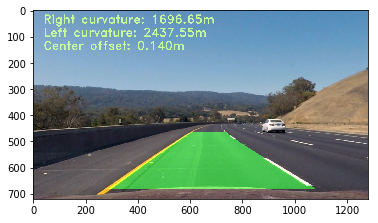

In [370]:
def image_processing(original_img): 
    #Get the inverse matrix from the perspective transform
    Minv = perspectiv_trans(original_img)[1]
    # Get binary image using combination of some tresholding methods
    combined_new1 = combined(original_img)[0]
    undist = combined(original_img)[1]
    comb_prp_new1 = perspectiv_trans(combined_new1)[0]
    left_curv, right_curv,center_dist,left_fit,right_fit = measure_curvature_real(combined_new1)
    #if left_fit is not None:
    #    out_img,left_fit,right_fit,ploty,left_fitx, right_fitx,lefty,lefty, rightx,righty,leftx_base, rightx_base = findpixel_around_poly(comb_prp_new1,left_fit,right_fit)
    #    left_curv, right_curv,center_dist = measure_curvature_real2(combined_new1)
    #else:
    #    out_img,left_fit,right_fit,ploty,left_fitx, right_fitx,lefty,lefty, rightx,righty,leftx_base, rightx_base = find_lane_pixels_and_ployfit(comb_prp_new1)
     #   left_curv, right_curv,center_dist,left_fit = measure_curvature_real(combined_new1)

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(comb_prp_new1).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    # Obtain arrays ploty, left_fitx and right_fitx from the line 
    # from polynomial fit
    #left_fitx, right_fitx, ploty = fit_poly_new(comb_prp_new1)  
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (original_img.shape[1], original_img.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.5, 0)
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Right curvature: ' + '{:04.2f}'.format(right_curv) + 'm'
    cv2.putText(result, text, (40,50), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    text = 'Left curvature: ' + '{:04.2f}'.format(left_curv) + 'm'
    cv2.putText(result, text, (40,100), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    text = 'Center offset: ' + '{:04.3f}'.format(center_dist) + 'm'
    cv2.putText(result, text, (40,150), font, 1.5, (200,255,155), 2, cv2.LINE_AA)

    return result
result44 = draw_roi(img_new1)
#plt.figure(figsize=(20,10))
plt.imshow(result44)

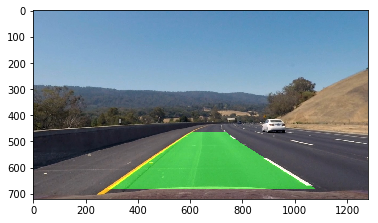

In [308]:
def draw_lane(original_img,left_fitx, right_fitx, ploty):
    #Get the inverse matrix from the perspective transform
    Minv = perspectiv_trans(original_img)[1]
    # Get binary image using combination of some tresholding methods
    combined_new1 = combined(original_img)[0]
    undist = combined(original_img)[1]
    comb_prp_new1 = perspectiv_trans(combined_new1)[0]
    left_curv, right_curv,center_dist = measure_curvature_real(comb_prp_new1)

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(comb_prp_new1).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    # Obtain arrays ploty, left_fitx and right_fitx from the line 
    # from polynomial fit
    #left_fitx, right_fitx, ploty = fit_poly_new(comb_prp_new1)  
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (original_img.shape[1], original_img.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.5, 0)

    return result
out_img = draw_lane(img_new1,left_fitx, right_fitx, ploty)
plt.imshow(out_img)

### Test on Videos

In [109]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML


In [371]:
leftl = Line()
rightl = Line()
white_output = 'project_video_advn2.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4") #.subclip(0,1)
white_clip = clip1.fl_image(image_processing) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

ValueError: too many values to unpack (expected 3)

In [ ]:
white_output = 'challenge_video1.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("challenge_video.mp4").subclip(0,10)
white_clip = clip1.fl_image(draw_roi) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)